# $\nu_e$  Selection and Calorimetry

Electron neutrinos in LArTPCs are detected by reconstructing the final state topology of the $\nu_e + Ar$ interaction. The target topology will depend on what interaction type or mode you want to include in your study.`
 
### Contents
 1. Introduction and Setup
 2. Truth Studies
 3. Flash Matching Performance Summary
 4. $1e1p$ Selection Summary
 5. $\nu_e$ Calorimetry

## 1. Introduction and Setup

We will first setup all boilerplate code and load files to memory.
 * Data file: `/sdf/group/neutrino/icarus/bnb_nue_corsika/mlreco_05312023/mlreco_output_bnb_nue_corsika_sim.h5`
 * Post-processors:
   * `match_particles`: For particle-level energy reconstruction analysis.
   * `match_interactions`: For interaction topology selection and flash-matching.
   * `range_based_kinetic_energy`: For reconstructing range-based kinetic energy for protons.
   * `reconstruct_direction`: For reconstructing particle directions for two-body kinematic energy reconstruction. 
   * `fiducial_cut`: for making containment cut (should be renamed to containment cut)

> **Note**:
> Normally, we also include flash-matching as a part of selection / reconstruction. For the data file above, the flash-matching results are already stored inside each `Interaction` objects.

In [1]:
pwd

'/sdf/home/k/koh0207/workshop/icarus_ml_workshop_2023/analysis/nue'

In [2]:
# Basic boilerplate imports
import numpy as np
import pandas as pd
import yaml, os, sys, re
import warnings
from pandas.errors import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

# Visualization Tools
import plotly
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={
    'figure.figsize':(20, 10), 
})
sns.set_context('talk') # or paper


In [3]:
SOFTWARE_DIR = '/sdf/group/neutrino/koh0207/lartpc_mlreco3d' # Change this path to your software install
DATA_PATH = '/sdf/data/neutrino/icarus/workshop2023/reco/bnb_nue_corsika_mini_reco.h5' # Change this path if you are not on SDF (see main README)

# Set software directory
sys.path.append(SOFTWARE_DIR)
from mlreco.utils.globals import *

Welcome to JupyROOT 6.22/08


In [4]:
# Load anatools config file
anaconfig = './nue_selection.cfg'
anaconfig = yaml.safe_load(open(anaconfig, 'r').read().replace('DATA_PATH', DATA_PATH))

In [5]:
# Initialize Anatools manager
from analysis.manager import AnaToolsManager
manager = AnaToolsManager(anaconfig, cfg=None)
manager.initialize()

Registered /sdf/data/neutrino/icarus/workshop2023/reco/bnb_nue_corsika_mini_reco.h5


In [6]:
ENTRY_NUM = 2
data, result = manager.forward(iteration=ENTRY_NUM)

In [7]:
# manager.build_representations(data, result, mode='all')
manager.load_representations(data, result, mode='all')
manager.run_post_processing(data, result)

In [8]:
# Retrieving data structures
particles          = result['particles'][0]
truth_particles    = result['truth_particles'][0]
interactions       = result['interactions'][0]
truth_interactions = result['truth_interactions'][0]

First, let's plot the images to get a sense of how the nue samples look like:

In [9]:
from mlreco.visualization.plotly_layouts import plotly_layout3d
from mlreco.visualization.points import get_event_displays

We plot `pid` for reco objects and `nu_id` for truth objects:

In [10]:
# Example traces (3d scatterplots)
# Feel free to change the `color` or `mode` attribute to visualize different particle attributes. 
traces_reco = get_event_displays(particles, color='pid', size=1, mode='points', colorscale='rainbow')
traces_true = get_event_displays(truth_particles, color='nu_id', size=1, mode='truth_points', colorscale='rainbow')

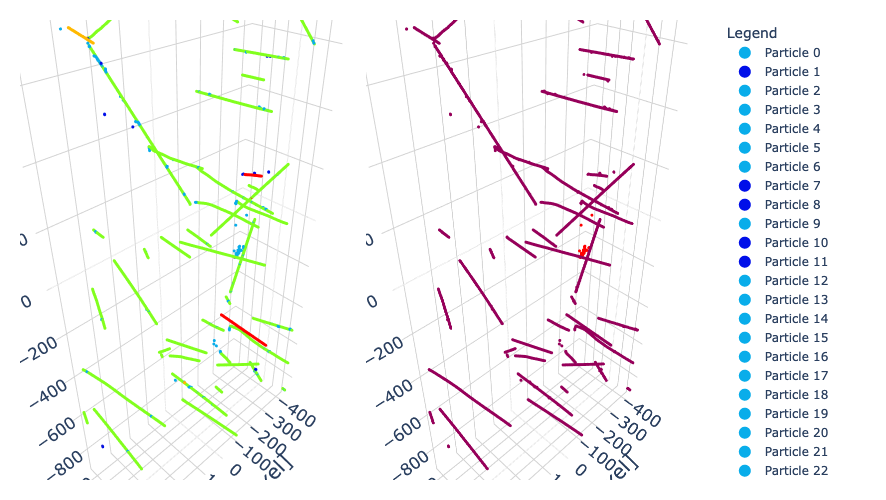

In [11]:
# Template cell for side-by-side event displays
make_plots = True
if make_plots:
    fig = make_subplots(rows=1, cols=2,
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                        horizontal_spacing=0.05, vertical_spacing=0.04)

    fig.add_traces(traces_reco, rows=len(traces_reco) * [1], cols=len(traces_reco) * [1])
    fig.add_traces(traces_true, rows=len(traces_true) * [1], cols=len(traces_true) * [2])

    fig.layout = plotly_layout3d()
    fig.update_layout(showlegend=True,
                      legend=dict(xanchor="left"),
                     autosize=True,
                     height=500,
                     width=1000,
                     margin=dict(r=20, l=20, b=20, t=20))
    fig.update_layout(scene1_aspectmode='data')
    fig.update_layout(scene2_aspectmode='data')
    iplot(fig)

In [12]:
# Example traces (3d scatterplots)
# Feel free to change the `color` or `mode` attribute to visualize different particle attributes. 
traces_reco = get_event_displays(interactions, 
                                 color='id', 
                                 size=1, 
                                 mode='points', 
                                 colorscale='rainbow',
                                 scatter_vertices=True)
traces_true = get_event_displays(truth_interactions, 
                                 color='id', 
                                 size=1, 
                                 mode='truth_points', 
                                 colorscale='rainbow',
                                 scatter_vertices=True)

At this stage, we already have all information needed to run event selection. Since producing the necessary csv files require a fair amount of time, I have already generated 1000 image worth of BNB $\nu_e$ reconstruction outputs. 

In [13]:
# Mappings for Neutrino information integer code to string
from mlreco.utils.globals import NU_CURR_TYPE, NU_INT_TYPE

In [14]:
# Load all generated csv files
df_intrs_t2r = pd.read_csv('/sdf/data/neutrino/icarus/workshop2023/csvs/nue/t2r/interactions.csv')
df_parts_t2r = pd.read_csv('/sdf/data/neutrino/icarus/workshop2023/csvs/nue/t2r/particles.csv')

df_intrs_r2t = pd.read_csv('/sdf/data/neutrino/icarus/workshop2023/csvs/nue/r2t/interactions.csv')
df_parts_r2t = pd.read_csv('/sdf/data/neutrino/icarus/workshop2023/csvs/nue/r2t/particles.csv')

# Convert numeric labels to strings
df_intrs_t2r['true_nu_interaction_type'] = df_intrs_t2r['true_nu_interaction_type'].map(NU_INT_TYPE)
df_intrs_r2t['true_nu_interaction_type'] = df_intrs_r2t['true_nu_interaction_type'].map(NU_INT_TYPE)

df_intrs_t2r['true_nu_current_type'] = df_intrs_t2r['true_nu_current_type'].map(NU_CURR_TYPE)
df_intrs_r2t['true_nu_current_type'] = df_intrs_r2t['true_nu_current_type'].map(NU_CURR_TYPE)

For demonstration, we will first work with `true -> reco` matched neutrino interactions:

In [15]:
df_nues = df_intrs_t2r.query('true_nu_id == 1 and true_nu_energy_init > 0')

## 2. Truth Studies

Let us first look at truth information to get a sense of what interaction types we should expect at different $\nu_e$ initial energies. 

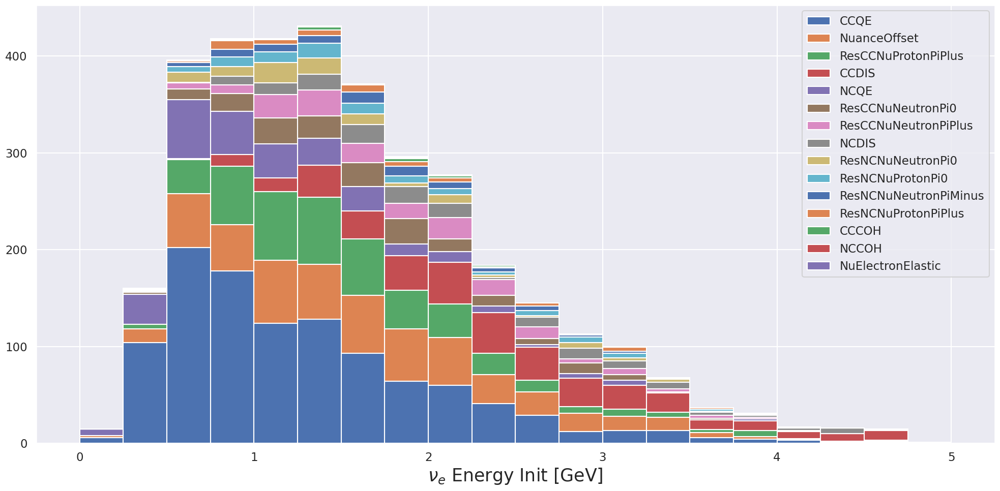

In [16]:
fig, ax = plt.subplots()
x, label = [], []
for nu_int_type in dict(df_nues['true_nu_interaction_type'].value_counts()):
    x.append(df_nues.query(f'true_nu_interaction_type == "{nu_int_type}"')['true_nu_energy_init'])
    label.append(nu_int_type)
ax.hist(x, range=(0, 5), bins=20, stacked=True, label=label)
ax.legend()
ax.set_xlabel('$\\nu_e$ Energy Init [GeV]', fontsize=25)
fig.tight_layout()

We may also look at the distributions with respect to the true topology:

In [17]:
# To avoid confusion, let's initialize a separate dataframe
df_topology = pd.DataFrame()
df_topology['true_topology'] = df_nues.apply(lambda row: '{}e{}p'.format(
    row['true_num_primary_electrons'], 
    row['true_num_primary_protons']), axis=1)
df_topology['true_nu_interaction_type'] = df_nues['true_nu_interaction_type']
df_topology['true_nu_energy_init'] = df_nues['true_nu_energy_init']

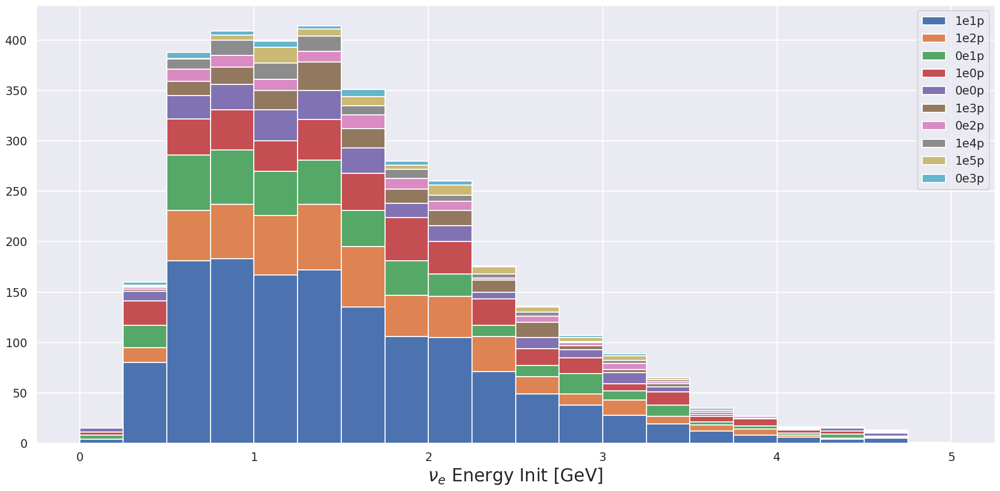

In [18]:
fig, ax = plt.subplots()
x, label = [], []
for nu_int_type, val in dict(df_topology['true_topology'].value_counts()).items():
    if val < df_topology['true_topology'].shape[0] * 0.01:
        continue
    x.append(df_topology.query(f'true_topology == "{nu_int_type}"')['true_nu_energy_init'])
    label.append(nu_int_type)
ax.hist(x, range=(0, 5), bins=20, stacked=True, label=label)
ax.legend()
ax.set_xlabel('$\\nu_e$ Energy Init [GeV]', fontsize=25)
fig.tight_layout()

## 3. Flash-matching

Recall that the ICARUS beam window is 0-1.6$\mu s$, hence the `flash_time` from the reconstructed neutrino interaction must lie between 0 and 1.6$\mu s$. Let us make a boolean column `reco_flash_within_window` to mark which reco interactions are flash-matched with flash time within the beam window:

In [19]:
df_intrs_t2r['reco_flash_within_window'] = (df_intrs_t2r['reco_flash_time'] > 0) &  (df_intrs_t2r['reco_flash_time'] < 1.6)
df_intrs_r2t['reco_flash_within_window'] = (df_intrs_r2t['reco_flash_time'] > 0) &  (df_intrs_r2t['reco_flash_time'] < 1.6)
df_nues['reco_flash_within_window']      = (df_nues['reco_flash_time'] > 0) &  (df_nues['reco_flash_time'] < 1.6)

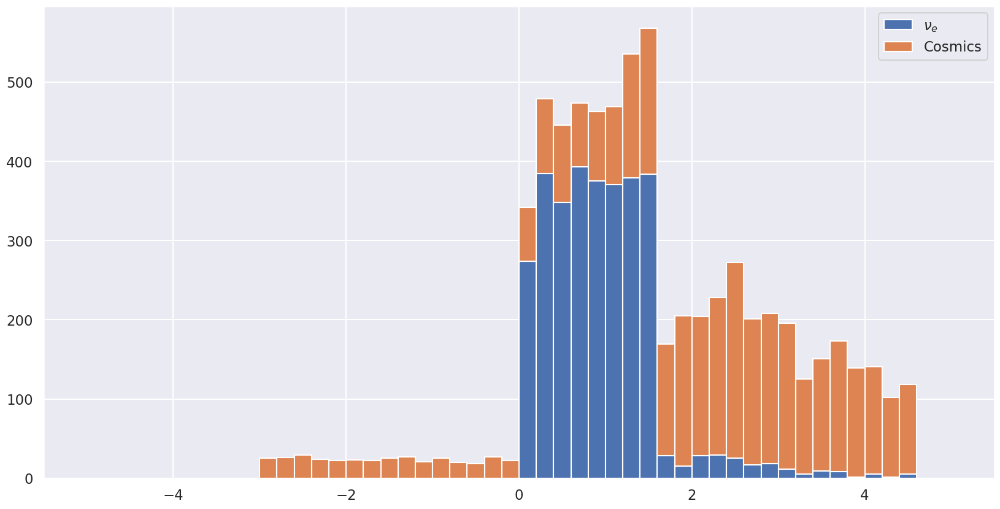

In [20]:
x = df_intrs_t2r.query(
    'reco_flash_time > -1000 and reco_flash_time < 1000 and true_nu_id == 1')['reco_flash_time']

y = df_intrs_t2r.query(
    'reco_flash_time > -1000 and reco_flash_time < 1000 and true_nu_id == 0')['reco_flash_time']

fig, ax = plt.subplots()
ax.hist([x,y], bins=50, range=(-5, 5), stacked=True, label=['$\\nu_e$', 'Cosmics'])
ax.legend()

In [21]:
from sklearn.metrics import confusion_matrix
from mlreco.visualization.metrics import *
from utils import *

df_plot = pd.DataFrame()
df_plot['True Neutrino'] = df_intrs_t2r['true_nu_id'] == 1
df_plot['Flash In-Time'] = df_intrs_t2r['reco_flash_within_window']

df_plot2 = pd.DataFrame()
df_plot2['True Neutrino'] = df_intrs_r2t['true_nu_id'] == 1
df_plot2['Flash In-Time'] = df_intrs_r2t['reco_flash_within_window']

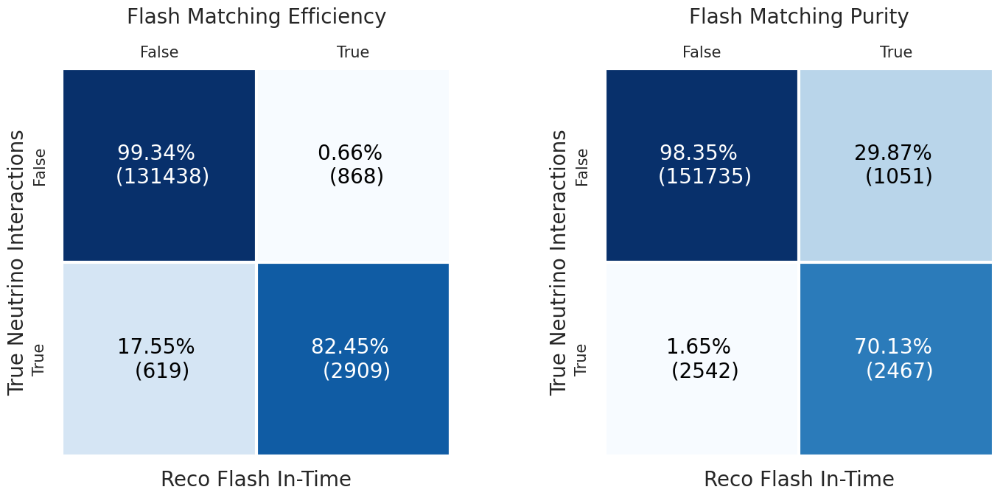

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

im1, text1, labels = make_confusion_matrix(df_plot, truth_name='True Neutrino', pred_name='Flash In-Time', ax=ax[0])
row_labels, col_labels = labels
ax[0].grid(None)
ax[0].set_ylabel('True Neutrino Interactions', fontsize=20)
ax[0].set_xlabel('Reco Flash In-Time', fontsize=20)
ax[0].set_yticklabels(row_labels, fontsize=15, va='center', rotation=90)
ax[0].set_xticklabels(col_labels, fontsize=15, va='center', rotation =0)
ax[0].set_title('Flash Matching Efficiency', y=1.1, fontsize=20)
ax[0].tick_params(axis='both', length=0, pad=15)

im2, text2, labels = make_confusion_matrix(df_plot2, truth_name='True Neutrino', 
                                           pred_name='Flash In-Time', ax=ax[1], normalize='pred')
row_labels, col_labels = labels
ax[1].grid(None)
ax[1].set_ylabel('True Neutrino Interactions', fontsize=20)
ax[1].set_xlabel('Reco Flash In-Time', fontsize=20)
ax[1].set_yticklabels(row_labels, fontsize=15, va='center', rotation=90)
ax[1].set_xticklabels(col_labels, fontsize=15, va='center', rotation =0)
ax[1].set_title('Flash Matching Purity', y=1.1, fontsize=20)
ax[1].tick_params(axis='both', length=0, pad=15)
fig.tight_layout()

These numbers report the "pure flash-matching" purity and efficiency values--the important numbers are the lower right cells in the confusion matrices. 
 * Efficiency (how well we recover true $\nu_e$'s): **81.94%** of all true neutrino interactions have a matched reco interaction with an *in-time* flash. Therefore, any additional selection using event topology on top of flash-matching cannot exceed an efficiency of **81.94%**. 
 * Purity (what percentage of reconstructed $\nu_e$'s are true $\nu_e$'s): **68.59%** of all reconstructed interactions with *in-time* flash are actual true $\nu_e$'s. Hence, **68.59%** is the minimum purity that we get for free, using only flash-matching. 

## 4. 1e1p $\nu_e$ Selection

Selecting reco interactions with 1e1p topology is simple:

In [23]:
def make_confusion_matrix(df_plot, truth_name='Truth', pred_name='Prediction', normalize='true', ax=None):
    
    labels     = sorted(set(list(df_plot[truth_name].unique()) + list(df_plot[pred_name].unique())))
    row_labels = sorted(set(list(df_plot[truth_name].unique())))
    col_labels = sorted(set(list(df_plot[pred_name].unique())))
    
    cm = confusion_matrix(df_plot[truth_name], df_plot[pred_name], normalize=normalize, labels=labels)
    cm_counts = confusion_matrix(df_plot[truth_name], df_plot[pred_name], labels=labels)
    
    cm = cm[:, np.where(cm.sum(axis=0) > 0)[0]]
    cm_counts = cm_counts[:, np.where(cm_counts.sum(axis=0) > 0)[0]]

    cm = cm[np.where(cm.sum(axis=1) > 0)[0], :]
    cm_counts = cm_counts[np.where(cm_counts.sum(axis=1) > 0)[0], :]
    
    im = heatmap(cm * 100, 
             row_labels, 
             col_labels, 
             ax=ax, cmap="Blues")
    texts = annotate_heatmap(im, unc=cm_counts, valfmt="{:.2f}% \n ({:.0f})", fontsize=20)
    
    return im, texts, (row_labels, col_labels)

In [24]:
# Dataframe for plotting
df_plot = pd.DataFrame()
# Signal definition
signal_mask = (df_intrs_t2r['reco_num_primary_electrons'] == 1) \
            & (df_intrs_t2r['reco_num_primary_protons'] == 1) \
            & df_intrs_t2r['reco_flash_within_window']

true_mask = (df_intrs_t2r['true_num_primary_electrons'] == 1) \
            & (df_intrs_t2r['true_num_primary_protons'] == 1)

df_plot['Index'] = df_intrs_t2r['Index']
df_plot['reco_interaction_id'] = df_intrs_t2r['reco_interaction_id']
# Set Selection Truth Labels
df_plot['Truth'] = 'Other'
df_plot['Truth'][df_intrs_t2r['true_nu_id'] == 0] = 'Cosmic'
df_plot['Truth'][true_mask] = 'True $\\nu_e$ 1e1p'
df_plot['Truth'][(~true_mask) & (df_intrs_t2r['true_nu_id'] == 1)] = 'True $\\nu_e$ Other'

print("{:.2f}% of TruthInteractions are not matched with any Reco Interaction".format(
    100 * df_plot.query('reco_interaction_id == -1').shape[0] / df_plot.shape[0]))
df_plot = df_plot.query('reco_interaction_id != -1')
# Set Selection Reco Labels
df_plot['Prediction'] = 'Background'
df_plot['Prediction'][signal_mask] = '1e1p+FM'

0.13% of TruthInteractions are not matched with any Reco Interaction


In [25]:
# Dataframe for plotting
df_plot2 = pd.DataFrame()
# Signal definition
signal_mask = (df_intrs_r2t['reco_num_primary_electrons'] == 1) \
            & (df_intrs_r2t['reco_num_primary_protons'] == 1) \
            & df_intrs_r2t['reco_flash_within_window']

true_mask = (df_intrs_r2t['true_num_primary_electrons'] == 1) \
            & (df_intrs_r2t['true_num_primary_protons'] == 1)

df_plot2['Index'] = df_intrs_r2t['Index']
df_plot2['true_interaction_id'] = df_intrs_r2t['true_interaction_id']
# Set Selection Truth Labels
df_plot2['Truth'] = 'Other'
df_plot2['Truth'][df_intrs_r2t['true_nu_id'] == 0] = 'Cosmic'
df_plot2['Truth'][true_mask] = 'True $\\nu_e$ 1e1p'
df_plot2['Truth'][(~true_mask) & (df_intrs_r2t['true_nu_id'] == 1)] = 'True $\\nu_e$ Other'

# Set Selection Reco Labels
df_plot2['Prediction'] = 'Background'
df_plot2['Prediction'][signal_mask] = '1e1p+FM'

print("{:.2f}% of Reco Interactions are not matched with any TruthInteraction".format(
    100 * df_plot2.query('true_interaction_id == -1').shape[0] / df_plot2.shape[0]))
df_plot2 = df_plot2.query('true_interaction_id != -1')

2.11% of Reco Interactions are not matched with any TruthInteraction


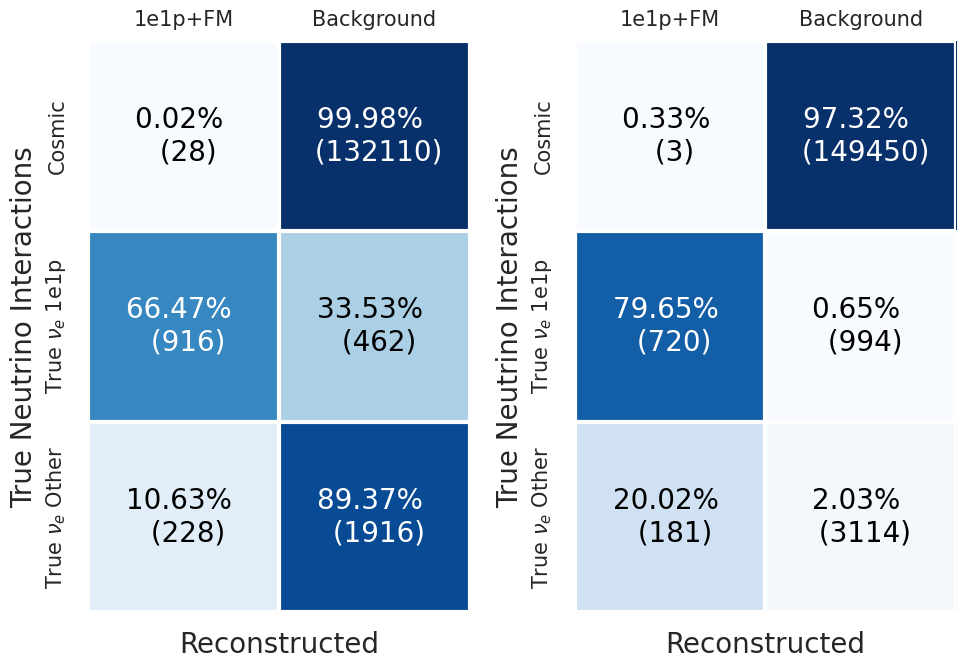

In [26]:
fig, ax = plt.subplots(1, 2, figsize=(10, 8))

im1, text1, labels = make_confusion_matrix(df_plot, ax=ax[0])
row_labels, col_labels = labels
ax[0].grid(None)
ax[0].set_ylabel('True Neutrino Interactions', fontsize=20)
ax[0].set_xlabel('Reconstructed', fontsize=20)
ax[0].set_yticklabels(row_labels, fontsize=15, va='center', rotation=90)
ax[0].set_xticklabels(col_labels, fontsize=15, va='center', rotation =0)
# ax[0].set_title('Flash Matching Efficiency', y=1.1, fontsize=20)
ax[0].tick_params(axis='both', length=0, pad=15)

im2, text2, labels2 = make_confusion_matrix(df_plot2, ax=ax[1], normalize='pred')
row_labels, col_labels = labels2
ax[1].grid(None)
ax[1].set_ylabel('True Neutrino Interactions', fontsize=20)
ax[1].set_xlabel('Reconstructed', fontsize=20)
ax[1].set_yticklabels(row_labels, fontsize=15, va='center', rotation=90)
ax[1].set_xticklabels(col_labels, fontsize=15, va='center', rotation =0)
# ax[1].set_title('Flash Matching Efficiency', y=1.1, fontsize=20)
ax[1].tick_params(axis='both', length=0, pad=15)
fig.tight_layout()

The important numbers are the signal selection efficiency (66.69%) and purity (77.70%)

> **Exercise**
> Generate the confusion matrices for 1eNp and 1eX selections.

## 5. $\nu_e$ Calorimetry

For demonstration we will use `true->reco` matched results. For calorimetry, it is necessary to have particle-level informartion to reconstruct the electron and proton energies separately:

In [27]:
df_nues = df_intrs_t2r.query('true_nu_id == 1')
df_particles = df_parts_t2r

Merging the two dataframes at `Index` and `interaction_id` will give us a dataframe that contains data from both particle and interaction-level attributes. That is, we merge columns from two datasets horizontally only if both `Index` and `interaction_id` agree. 

> **Note**: 
> In pandas, an inner join is a type of join operation that combines two DataFrames based on a common key or column, returning only the matching rows between the two DataFrames. The resulting DataFrame will contain only the rows where the key or column values exist in both DataFrames.

In [28]:
df = pd.merge(df_nues, 
              df_particles, 
              left_on=['Index', 'true_interaction_id'], # Because the names for "interaction_id"s are different
              right_on=['Index', 'true_particle_interaction_id'])

In [29]:
# Example
df.query('Index == 0 and true_interaction_id == 56')[['true_num_primary_electrons', 
                                                      'true_num_primary_protons',
                                                      'true_particle_type',
                                                      'true_particle_is_primary']]

,true_num_primary_electrons,true_num_primary_protons,true_particle_type,true_particle_is_primary
0,1,2,1,True
1,1,2,4,True
2,1,2,3,True
3,1,2,4,True
4,1,2,2,False
5,1,2,1,False


Here, you can see that the merged columns are "consistent". 

### 5-1. Reconstructing Electron and Proton Initial Energies

For electron and proton energy reconstruction, we require a series of cuts to ensure the assumptions required for our calorimetry method are satisfied. For protons, we require cuts on containment, secondaries, and visibility; for electrons, only the containment cut.

In [30]:
containment_cut = True
children_cut = True
proton_cut = True
reco_length_success_cut = False
reco_type_success_cut = False

query_electrons = 'true_particle_type == 1 and true_particle_semantic_type == 0'
query_protons = 'true_particle_type == 4 and true_particle_semantic_type == 1'
num_electrons, num_protons = df.query(query_electrons).shape[0], df.query(query_protons).shape[0]
print("All Electrons = ", num_electrons)
print("All Protons = ", num_protons)

if containment_cut:
    query_electrons += ' and true_particle_is_contained'
    query_protons += ' and true_particle_is_contained'
    print("e Containment Cut = {:.2f}%".format(df.query(query_electrons).shape[0] / num_electrons * 100))
    print("p Containment Cut = {:.2f}%".format(df.query(query_protons).shape[0] / num_protons * 100))
    
if children_cut:
    # Proton Secondary Cut: restrict to protons with no track secondaries
    query_protons += ' and true_children_counts_1 == 0'
    print("p Children Cut = {:.2f}%".format(df.query(query_protons).shape[0] / num_protons * 100))
    
if reco_type_success_cut:
    query_electrons += ' and reco_particle_type == 1'
    query_protons += ' and reco_particle_type == 4'
    print("e PID correctness cut = {:.2f}%".format(df.query(query_electrons).shape[0] / num_electrons * 100))
    print("p PID correctness cut = {:.2f}%".format(df.query(query_protons).shape[0] / num_protons * 100))
    
if proton_cut:
    # query_protons += ' and (reco_particle_length > 0)'
    query_protons += f' and (true_energy_init > 40+{PROTON_MASS})'
    print("Proton Visible E Cut = {:.2f}%".format(df.query(query_protons).shape[0] / num_protons * 100))


df_electrons = df.query(query_electrons)
df_protons = df.query(query_protons)

All Electrons =  2742
All Protons =  8465
e Containment Cut = 62.25%
p Containment Cut = 90.05%
p Children Cut = 80.06%
Proton Visible E Cut = 59.44%


### 5-2. Electron Shower Energy Reconstruction

We will do a simple (but incorrect) shower energy reconstruction using the sum of ADC values of true electron showers. Let us gather 100 electrons to be used in calibration. We will use `scipy.optimize.least_squares` to fit the calibration constant. 

In [31]:
from tqdm import tqdm
from scipy.optimize import least_squares

In [34]:
run_loop = False
if run_loop:
    calibration_electrons = []
    for i in tqdm(range(100)):
        data, result = manager.forward(iteration=i)
        manager.load_representations(data, result, mode='all')
        manager.run_post_processing(data, result)
        truth_particles = result['truth_particles'][0]
        electrons = [p for p in truth_particles if p.nu_id == 1 and \
                                                   p.semantic_type == 0 and \
                                                   p.pid == 1 and \
                                                   p.is_primary == 1 and \
                                                   p.is_contained]
        calibration_electrons.extend(electrons)
    df_calibration = pd.DataFrame()
    df_calibration['truth_depositions_sum'] = np.array([p.truth_depositions.sum() for p in calibration_electrons])
    df_calibration['true_energy_init'] = np.array([p.energy_init for p in calibration_electrons])
else:
    df_calibration = pd.read_csv('calibration.csv')

In [35]:
def linear_calibration(a, x, y):
    return (a[0] * x - y)

In [36]:
x0 = [2.0]
res_lsq = least_squares(linear_calibration, x0, args=(df_calibration['truth_depositions_sum'], 
                                                      df_calibration['true_energy_init']))
print("ADC to MeV Conversion Factor = {}".format(res_lsq.x))

ADC to MeV Conversion Factor = [0.0046398]


Text(0, 0.5, 'true_energy_init')

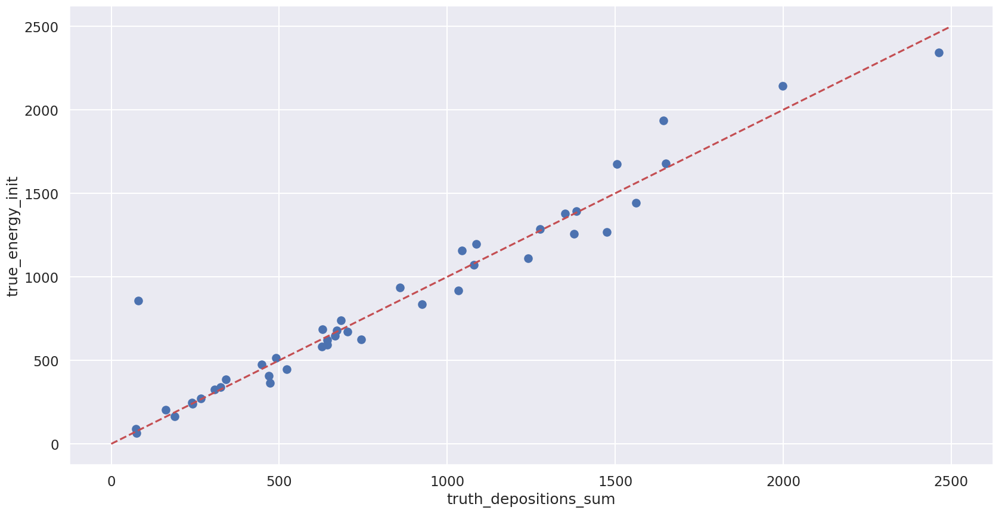

In [37]:
fig, ax = plt.subplots()
ax.scatter(df_calibration['truth_depositions_sum'] * res_lsq.x, df_calibration['true_energy_init'])
ax.errorbar(np.linspace(0, 2500, 10), np.linspace(0, 2500, 10), fmt='r--', )
ax.set_xlabel('truth_depositions_sum')
ax.set_ylabel('true_energy_init')

Now that we have computed the calibration factor from ADCs to MeV, we may apply the factor to our electron dataframe to compute the reconstructed calorimetric shower energy. 

In [38]:
df_electrons['true_particle_calo_energy'] = df_electrons['true_particle_depositions_sum'] * res_lsq.x
df_electrons['reco_particle_calo_energy'] = df_electrons['reco_particle_depositions_sum'] * res_lsq.x

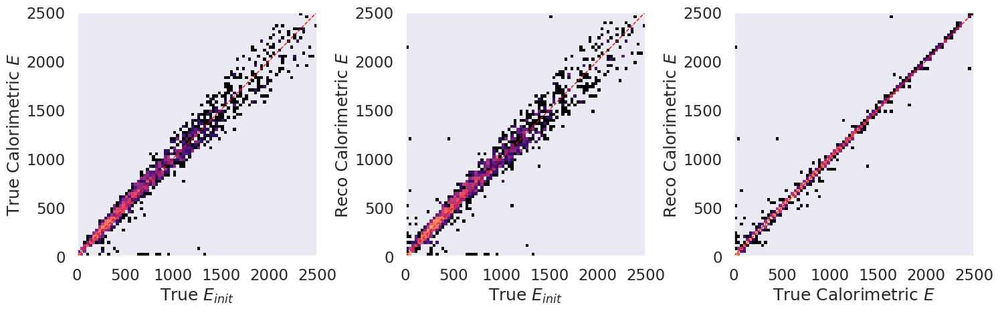

In [39]:
from matplotlib.colors import LogNorm
fig, ax = plt.subplots(1, 3, figsize=(15, 5), sharey=False)

ax[0].hist2d(df_electrons['true_energy_init'], df_electrons['true_particle_calo_energy'], bins=(80, 80), range=[(0, 2500), (0, 2500)], norm=LogNorm(), cmap='magma')
ax[0].set_ylabel('True Calorimetric $E$')
ax[0].set_xlabel('True $E_{init}$')
ax[0].plot(np.arange(0, 2500, 10), np.arange(0, 2500, 10), c='red', linestyle='--', linewidth=1)

ax[1].hist2d(df_electrons['true_energy_init'], df_electrons['reco_particle_calo_energy'], bins=(80, 80), range=[(0, 2500), (0, 2500)], norm=LogNorm(), cmap='magma')
ax[1].plot(np.arange(0, 2500, 10), np.arange(0, 2500, 10), c='red', linestyle='--', linewidth=1)
ax[1].set_ylabel('Reco Calorimetric $E$')
ax[1].set_xlabel('True $E_{init}$')

hist = ax[2].hist2d(df_electrons['true_particle_calo_energy'], df_electrons['reco_particle_calo_energy'], bins=(80, 80), range=[(0, 2500), (0, 2500)], norm=LogNorm(), cmap='magma')
ax[2].plot(np.arange(0, 2500, 10), np.arange(0, 2500, 10), c='red', linestyle='--', linewidth=1)
ax[2].set_ylabel('Reco Calorimetric $E$')
ax[2].set_xlabel('True Calorimetric $E$')
    
fig.tight_layout()

### 5-3. Proton Range-Based Energy Reconstruction

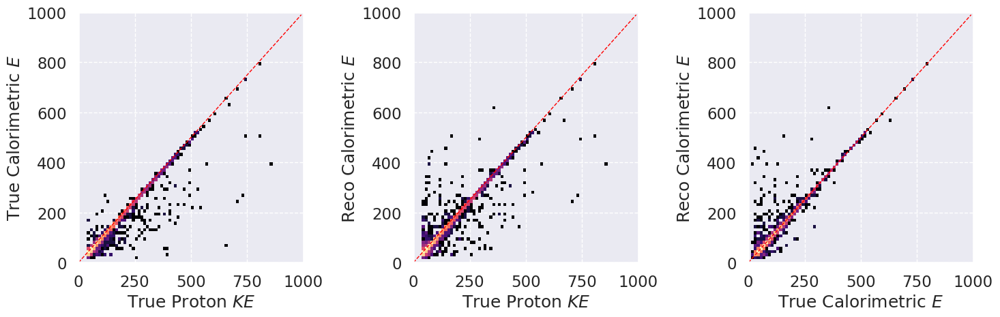

In [40]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5), sharey=False)

ax[0].hist2d(df_protons['true_energy_init'] - PROTON_MASS, df_protons['true_csda_kinetic_energy'], bins=(80, 80), range=[(0, 1000), (0, 1000)], norm=LogNorm(), cmap='magma')
ax[0].set_ylabel('True Calorimetric $E$')
ax[0].set_xlabel('True Proton $KE$')
ax[0].plot(np.arange(0, 1000, 10), np.arange(0, 1000, 10), c='red', linestyle='--', linewidth=1)

ax[1].hist2d(df_protons['true_energy_init'] - PROTON_MASS, df_protons['reco_csda_kinetic_energy'], bins=(80, 80), range=[(0, 1000), (0, 1000)], norm=LogNorm(), cmap='magma')
ax[1].plot(np.arange(0, 1000, 10), np.arange(0, 1000, 10), c='red', linestyle='--', linewidth=1)
ax[1].set_ylabel('Reco Calorimetric $E$')
ax[1].set_xlabel('True Proton $KE$')

hist = ax[2].hist2d(df_protons['true_csda_kinetic_energy'], df_protons['reco_csda_kinetic_energy'], bins=(80, 80), range=[(0, 1000), (0, 1000)], norm=LogNorm(), cmap='magma')
ax[2].plot(np.arange(0, 1000, 10), np.arange(0, 1000, 10), c='red', linestyle='--', linewidth=1)
ax[2].set_ylabel('Reco Calorimetric $E$')
ax[2].set_xlabel('True Calorimetric $E$')

for a in ax:
    # a.axhline(ELECTRON_MASS, linewidth=1, color='blue', linestyle='--')
    # a.axvline(ELECTRON_MASS, linewidth=1, color='blue', linestyle='--', label='$m_e$')
    a.grid(linestyle='--', linewidth=1)
# ax.set_xlim(-50, 2000)
# ax.set_ylim(-50, 2000)
    # a.set_ylabel('Reco Depositions Sum (MeV)')
    # a.legend(loc='upper left')
    
fig.tight_layout()

### 5-4. $\nu_e$ Energy Reconstruction.

Let us first reconstruct the $\nu_e$ initial energy by summing the range-based proton energy and the electron shower energy:
$$ E_{\nu_e}^{init} := E_e + \sum_{i \in protons} E_p^i$$

In [47]:
run_cell = False
if run_cell:
    df_nu_ints = reconstruct_nu_energy(df, correction_factor=res_lsq.x)
else:
    df_nu_ints = pd.read_csv('nues.csv')

In [48]:
# Look at all reconstructed interactions
df_plot = df_nu_ints

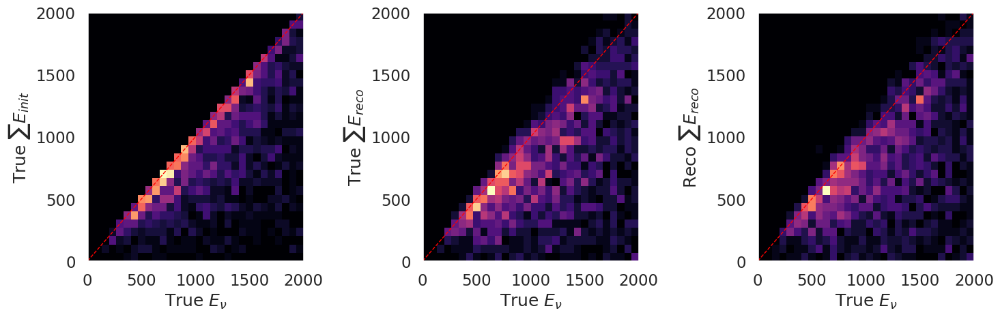

In [49]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].hist2d(df_plot['true_nu_energy'] * 1000, df_plot['true_Einit_sum'], bins=(30, 30), range=[(0, 2000), (0, 2000)], cmap='magma')
ax[1].hist2d(df_plot['true_nu_energy'] * 1000, df_plot['true_reco_E'], bins=(30, 30), range=[(0, 2000), (0, 2000)], cmap='magma')
ax[2].hist2d(df_plot['true_nu_energy'] * 1000, df_plot['reco_reco_E'], bins=(30, 30), range=[(0, 2000), (0, 2000)], cmap='magma')
for a in ax:
    a.plot(np.arange(0, 2000, 3), np.arange(0, 2000, 3), color='red', linewidth=1, linestyle='--')
    a.grid(linewidth=1, linestyle='--', alpha=0.5)
    
ax[0].set_xlabel('True $E_{\\nu}$')
ax[0].set_ylabel('True $\\sum E_{init}$')

ax[1].set_xlabel('True $E_{\\nu}$')
ax[1].set_ylabel('True $\\sum E_{reco}$')

ax[2].set_xlabel('True $E_{\\nu}$')
ax[2].set_ylabel('Reco $\\sum E_{reco}$')
    
fig.tight_layout()

In [50]:
# See if the true vs reco resolution improves if limited to CCQE
df_plot = df_nu_ints.query('true_nu_interaction_type == "CCQE"')

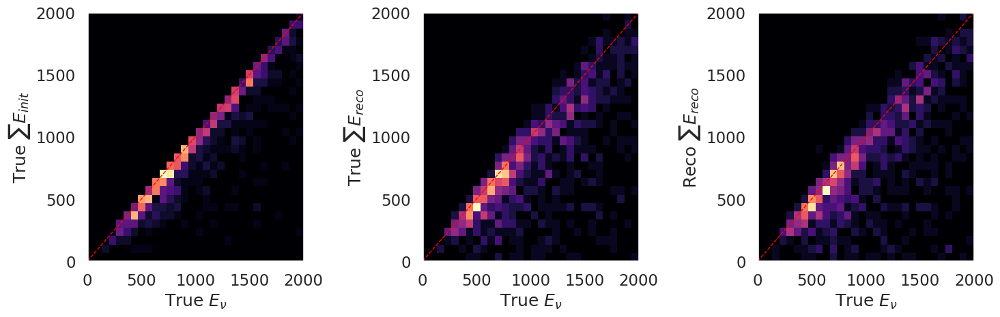

In [51]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].hist2d(df_plot['true_nu_energy'] * 1000, df_plot['true_Einit_sum'], bins=(30, 30), range=[(0, 2000), (0, 2000)], cmap='magma')
ax[1].hist2d(df_plot['true_nu_energy'] * 1000, df_plot['true_reco_E'], bins=(30, 30), range=[(0, 2000), (0, 2000)], cmap='magma')
ax[2].hist2d(df_plot['true_nu_energy'] * 1000, df_plot['reco_reco_E'], bins=(30, 30), range=[(0, 2000), (0, 2000)], cmap='magma')
for a in ax:
    a.plot(np.arange(0, 2000, 3), np.arange(0, 2000, 3), color='red', linewidth=1, linestyle='--')
    a.grid(linewidth=1, linestyle='--', alpha=0.5)
    
ax[0].set_xlabel('True $E_{\\nu}$')
ax[0].set_ylabel('True $\\sum E_{init}$')

ax[1].set_xlabel('True $E_{\\nu}$')
ax[1].set_ylabel('True $\\sum E_{reco}$')

ax[2].set_xlabel('True $E_{\\nu}$')
ax[2].set_ylabel('Reco $\\sum E_{reco}$')
    
fig.tight_layout()

### 5-5. Two-Body CCQE $\nu_e$ Energy Reconstruction.

For two-body CCQE ($\nu_e + n \rightarrow p + e$) topologies, the kinematics constraint gives an analytic formula for the neutrino energy in terms of the lepton energy and momentum (from [paper](https://arxiv.org/pdf/2110.14080.pdf)):

$$ E_\nu^{QE-l} = 0.5 * \frac{2 \cdot (m_n -B) \cdot E_l - [(m_n - B)^2 + m_l^2 - m_p^2)]}{(m_n - B) - E_l + \sqrt{E_l^2 - m_l^2} \cdot \cos{\theta_l}} $$

where $m_n$, $m_p$, and $m_l$ are the neutron, proton, and lepton (electron) mass, and $\theta_l$ is the angle between the lepton momentum and the beam direction. 

In [52]:
BINDING_ENERGY = 40
NEUTRON_MASS = 940.6

def ccqe_E_lepton(cos_l, E_l, m_l):
    denom = (NEUTRON_MASS - BINDING_ENERGY) - E_l + np.sqrt((E_l**2 - m_l**2)) * cos_l
    numer = 2.0 * (NEUTRON_MASS - BINDING_ENERGY) * E_l - ((NEUTRON_MASS - BINDING_ENERGY)**2 + m_l**2 - PROTON_MASS**2)
    out = numer / denom
    return out * 0.5

In [53]:
df_ccqe_e = df_electrons.query('true_nu_interaction_type == "CCQE" and \
                                true_num_primary_electrons == 1 and \
                                true_num_primary_protons == 1')

In [54]:
electrons_true_dir = df_ccqe_e[['true_truth_start_dir_x', 'true_truth_start_dir_y', 'true_truth_start_dir_z']].values
electrons_reco_dir = df_ccqe_e[['reco_particle_start_dir_x', 'reco_particle_start_dir_y', 'reco_particle_start_dir_z']].values

electrons_true_E = df_ccqe_e['true_energy_init'].values
electrons_reco_E = df_ccqe_e['reco_particle_calo_energy'].values

In [55]:
true_twobody_E = ccqe_E_lepton(electrons_true_dir[:, -1], electrons_true_E, ELECTRON_MASS)
reco_twobody_E = ccqe_E_lepton(electrons_reco_dir[:, -1], electrons_reco_E, ELECTRON_MASS)

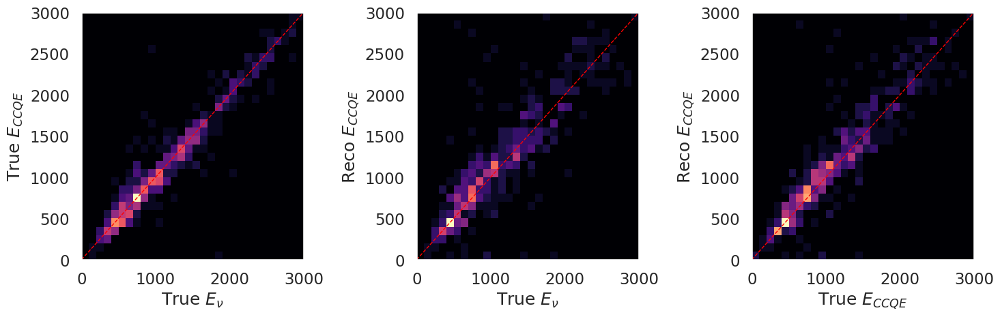

In [56]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].hist2d(df_ccqe_e['true_nu_energy_init'] * 1000, true_twobody_E, bins=(30, 30), range=[(0, 3000), (0, 3000)], cmap='magma')
ax[1].hist2d(df_ccqe_e['true_nu_energy_init'] * 1000, reco_twobody_E, bins=(30, 30), range=[(0, 3000), (0, 3000)], cmap='magma')
ax[2].hist2d(true_twobody_E, reco_twobody_E, bins=(30, 30), range=[(0, 3000), (0, 3000)], cmap='magma')
for a in ax:
    a.plot(np.arange(0, 3000, 3), np.arange(0, 3000, 3), color='red', linewidth=1, linestyle='--')
    a.grid(linewidth=1, linestyle='--', alpha=0.5)
    
ax[0].set_xlabel('True $E_{\\nu}$')
ax[0].set_ylabel('True $E_{CCQE}$')

ax[1].set_xlabel('True $E_{\\nu}$')
ax[1].set_ylabel('Reco $E_{CCQE}$')

ax[2].set_xlabel('True $E_{CCQE}$')
ax[2].set_ylabel('Reco $E_{CCQE}$')
    
fig.tight_layout()